In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import dtale
import dataprep
import plotly.express as px

%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

In [2]:
data = pd.read_csv('netflix_titles.csv')
data

,show_id,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,description
0,s1,Movie,Dick Johnson Is Dead,Kirsten Johnson,NaN,United States,"September 25, 2021",2020,PG-13,90 min,Documentaries,"As her father nears the end of his life, filmm..."
1,s2,TV Show,Blood & Water,NaN,"Ama Qamata, Khosi Ngema, Gail Mabalane, Thaban...",South Africa,"September 24, 2021",2021,TV-MA,2 Seasons,"International TV Shows, TV Dramas, TV Mysteries","After crossing paths at a party, a Cape Town t..."
2,s3,TV Show,Ganglands,Julien Leclercq,"Sami Bouajila, Tracy Gotoas, Samuel Jouy, Nabi...",NaN,"September 24, 2021",2021,TV-MA,1 Season,"Crime TV Shows, International TV Shows, TV Act...",To protect his family from a powerful drug lor...
3,s4,TV Show,Jailbirds New Orleans,NaN,NaN,NaN,"September 24, 2021",2021,TV-MA,1 Season,"Docuseries, Reality TV","Feuds, flirtations and toilet talk go down amo..."
4,s5,TV Show,Kota Factory,NaN,"Mayur More, Jitendra Kumar, Ranjan Raj, Alam K...",India,"September 24, 2021",2021,TV-MA,2 Seasons,"International TV Shows, Romantic TV Shows, TV ...",In a city of coaching centers known to train I...
...,...,...,...,...,...,...,...,...,...,...,...,...
8802,s8803,Movie,Zodiac,David Fincher,"Mark Ruffalo, Jake Gyllenhaal, Robert Downey J...",United States,"November 20, 2019",2007,R,158 min,"Cult Movies, Dramas, Thrillers","A political cartoonist, a crime reporter and a..."
8803,s8804,TV Show,Zombie Dumb,NaN,NaN,NaN,"July 1, 2019",2018,TV-Y7,2 Seasons,"Kids' TV, Korean TV Shows, TV Comedies","While living alone in a spooky town, a young g..."
8804,s8805,Movie,Zombieland,Ruben Fleischer,"Jesse Eisenberg, Woody Harrelson, Emma Stone, ...",United States,"November 1, 2019",2009,R,88 min,"Comedies, Horror Movies",Looking to survive in a world taken over by zo...
8805,s8806,Movie,Zoom,Peter Hewitt,"Tim Allen, Courteney Cox, Chevy Chase, Kate Ma...",United States,"January 11, 2020",2006,PG,88 min,"Children & Family Movies, Comedies","Dragged from civilian life, a former superhero..."


In [3]:
data = data.drop(['description'], axis = 1)
data = data.drop(['show_id'], axis = 1)

In [4]:
data

,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in
0,Movie,Dick Johnson Is Dead,Kirsten Johnson,NaN,United States,"September 25, 2021",2020,PG-13,90 min,Documentaries
1,TV Show,Blood & Water,NaN,"Ama Qamata, Khosi Ngema, Gail Mabalane, Thaban...",South Africa,"September 24, 2021",2021,TV-MA,2 Seasons,"International TV Shows, TV Dramas, TV Mysteries"
2,TV Show,Ganglands,Julien Leclercq,"Sami Bouajila, Tracy Gotoas, Samuel Jouy, Nabi...",NaN,"September 24, 2021",2021,TV-MA,1 Season,"Crime TV Shows, International TV Shows, TV Act..."
3,TV Show,Jailbirds New Orleans,NaN,NaN,NaN,"September 24, 2021",2021,TV-MA,1 Season,"Docuseries, Reality TV"
4,TV Show,Kota Factory,NaN,"Mayur More, Jitendra Kumar, Ranjan Raj, Alam K...",India,"September 24, 2021",2021,TV-MA,2 Seasons,"International TV Shows, Romantic TV Shows, TV ..."
...,...,...,...,...,...,...,...,...,...,...
8802,Movie,Zodiac,David Fincher,"Mark Ruffalo, Jake Gyllenhaal, Robert Downey J...",United States,"November 20, 2019",2007,R,158 min,"Cult Movies, Dramas, Thrillers"
8803,TV Show,Zombie Dumb,NaN,NaN,NaN,"July 1, 2019",2018,TV-Y7,2 Seasons,"Kids' TV, Korean TV Shows, TV Comedies"
8804,Movie,Zombieland,Ruben Fleischer,"Jesse Eisenberg, Woody Harrelson, Emma Stone, ...",United States,"November 1, 2019",2009,R,88 min,"Comedies, Horror Movies"
8805,Movie,Zoom,Peter Hewitt,"Tim Allen, Courteney Cox, Chevy Chase, Kate Ma...",United States,"January 11, 2020",2006,PG,88 min,"Children & Family Movies, Comedies"


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8807 entries, 0 to 8806
Data columns (total 10 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   type          8807 non-null   object
 1   title         8807 non-null   object
 2   director      6173 non-null   object
 3   cast          7982 non-null   object
 4   country       7976 non-null   object
 5   date_added    8797 non-null   object
 6   release_year  8807 non-null   int64 
 7   rating        8803 non-null   object
 8   duration      8804 non-null   object
 9   listed_in     8807 non-null   object
dtypes: int64(1), object(9)
memory usage: 688.2+ KB


In [6]:
data.describe()

,release_year
count,8807.000000
mean,2014.180198
std,8.819312
min,1925.000000
25%,2013.000000
50%,2017.000000
75%,2019.000000
max,2021.000000


In [7]:
data.isnull().sum()

type               0
title              0
director        2634
cast             825
country          831
date_added        10
release_year       0
rating             4
duration           3
listed_in          0
dtype: int64

### Data Cleaning

In [8]:
data = data.dropna(axis = 0)

NumExpr defaulting to 8 threads.


In [9]:
data.isnull().sum()

type            0
title           0
director        0
cast            0
country         0
date_added      0
release_year    0
rating          0
duration        0
listed_in       0
dtype: int64

In [10]:
data.date_added = pd.to_datetime(data['date_added'], infer_datetime_format = True)
data['Year'] = data['date_added'].dt.year
data['Month'] = data['date_added'].dt.month


### Type of Netflix Contents - Contain unique values of Movies and TV Shows

Movie      5185
TV Show     147
Name: type, dtype: int64


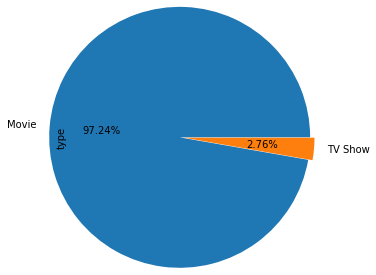

In [11]:
data_type = data.type.value_counts()
print(data_type)
data_type.plot(kind = 'pie',radius = 1.5,explode = [0, 0.05], autopct='%1.2f%%');

### Country with Maximum number of Movies and TV shows

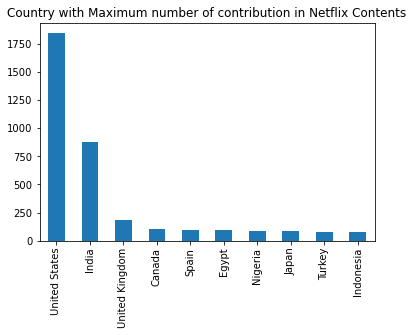

In [12]:
data_country_contrib = data.country.value_counts().sort_values(ascending = False).head(10)
data_country_contrib.plot.bar()
plt.title('Country with Maximum number of contribution in Netflix Contents');

### Analysis of Ratings

In [13]:
data_rating = data.rating.value_counts()
px.bar(data_rating)

### Distribution of Contents Release Year Trend

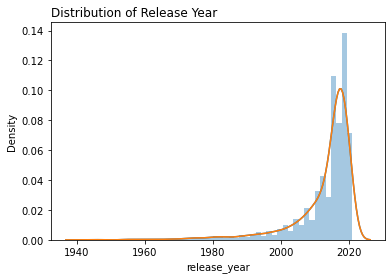

In [14]:
sns.distplot(data.release_year)
sns.kdeplot(data.release_year)
plt.title('Distribution of Release Year', loc = 'left');

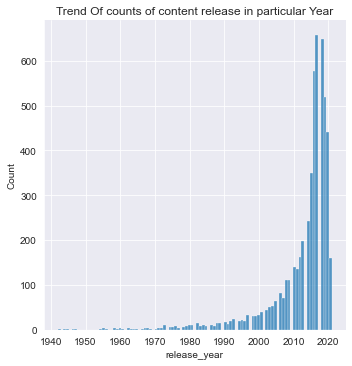

In [15]:
sns.set_style('darkgrid')
sns.displot(x = 'release_year', data = data, palette="hls")
plt.title('Trend Of counts of content release in particular Year');

### Director Analysis

In [16]:
data_director = data.director.value_counts().head(30)
data_director

Raúl Campos, Jan Suter    18
Marcus Raboy              15
Jay Karas                 14
Cathy Garcia-Molina       13
Jay Chapman               12
Youssef Chahine           12
Martin Scorsese           12
Steven Spielberg          11
Don Michael Paul          10
David Dhawan               9
Robert Rodriguez           8
Yılmaz Erdoğan             8
Ryan Polito                8
Shannon Hartman            8
Hakan Algül                8
Johnnie To                 8
Troy Miller                8
Toshiya Shinohara          7
Clint Eastwood             7
McG                        7
Ram Gopal Varma            7
Lance Bangs                7
Justin G. Dyck             7
Quentin Tarantino          7
Ron Howard                 7
Kunle Afolayan             7
Anees Bazmee               6
Steven Soderbergh          6
David Fincher              6
Sooraj R. Barjatya         6
Name: director, dtype: int64

In [17]:
Stanley_movies = data[data.director == 'Stanley Kubrick']
Stanley_movies[['title','rating','duration','release_year']]

,title,rating,duration,release_year
6031,A Clockwork Orange,R,137 min,1971
7332,Lolita,R,153 min,1962


In [18]:
Quentin_movies = data[data.director == 'Quentin Tarantino']
Quentin_movies

,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,Year,Month
392,Movie,Django Unchained,Quentin Tarantino,"Jamie Foxx, Christoph Waltz, Leonardo DiCaprio...",United States,2021-07-24,2012,R,165 min,"Action & Adventure, Dramas",2021,7
5203,Movie,The Hateful Eight,Quentin Tarantino,"Samuel L. Jackson, Kurt Russell, Jennifer Jaso...",United States,2017-10-25,2015,R,168 min,"Action & Adventure, Thrillers",2017,10
7077,Movie,Inglourious Basterds,Quentin Tarantino,"Brad Pitt, Mélanie Laurent, Christoph Waltz, E...","Germany, United States",2019-07-22,2009,R,153 min,Action & Adventure,2019,7
7113,Movie,Jackie Brown,Quentin Tarantino,"Pam Grier, Samuel L. Jackson, Robert Forster, ...",United States,2019-08-01,1997,R,154 min,"Dramas, Thrillers",2019,8
7197,Movie,Kill Bill: Vol. 1,Quentin Tarantino,"Uma Thurman, Lucy Liu, Vivica A. Fox, Daryl Ha...","United States, Japan",2020-01-01,2003,R,111 min,Action & Adventure,2020,1
7198,Movie,Kill Bill: Vol. 2,Quentin Tarantino,"Uma Thurman, David Carradine, Michael Madsen, ...",United States,2020-01-01,2004,R,137 min,Action & Adventure,2020,1
7802,Movie,Pulp Fiction,Quentin Tarantino,"John Travolta, Samuel L. Jackson, Uma Thurman,...",United States,2019-01-01,1994,R,154 min,"Classic Movies, Cult Movies, Dramas",2019,1


### Concentration of Contents added in Netflix

Text(0.5, 1.0, 'Concentration of Contents added in Netflix')

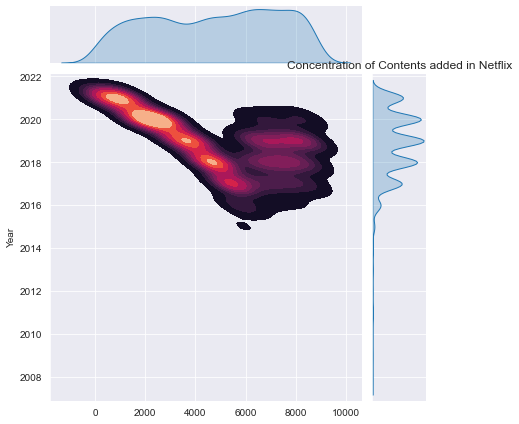

In [19]:
sns.jointplot(data = data.Year, kind = 'kde',fill=True, cmap="rocket")
plt.title('Concentration of Contents added in Netflix')

### Indian Movies

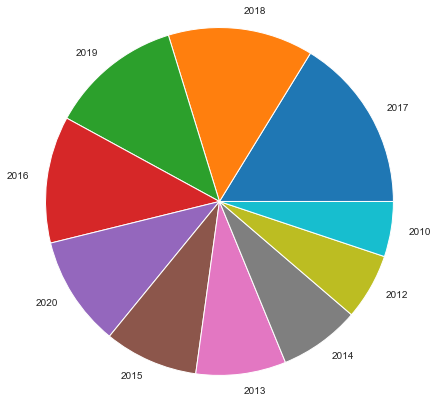

In [20]:
india_netflix_show = data[data.country == 'India']
top_10_most_no_of_movies_released = india_netflix_show.release_year.value_counts().head(10)
top_10_most_no_of_movies_released
top_10_most_no_of_movies_released.plot.pie(radius = 2);

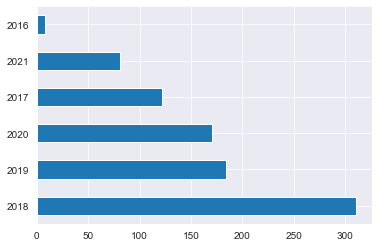

In [21]:
top_10_no_of_movies_added = india_netflix_show.Year.value_counts()
top_10_no_of_movies_added.plot.barh();

In [22]:
latest_release_india = data[(data['release_year'] == 2021) & (data.country== 'India')]
latest_release_india

,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,Year,Month
190,Movie,Thimmarusu,Sharan Koppisetty,"Satya Dev, Priyanka Jawalkar, Brahmaji",India,2021-08-28,2021,TV-14,125 min,"Dramas, International Movies",2021,8
297,TV Show,Navarasa,"Bejoy Nambiar, Priyadarshan, Karthik Narain, V...","Suriya, Vijay Sethupathi, Revathy, Prakash Raj...",India,2021-08-06,2021,TV-MA,1 Season,TV Shows,2021,8
551,Movie,Haseen Dillruba,Vinil Mathew,"Taapsee Pannu, Vikrant Massey, Harshvardhan Ra...",India,2021-07-02,2021,TV-MA,136 min,"International Movies, Romantic Movies, Thrillers",2021,7
735,Movie,Sarbath,Prabhakaran,"Kathir, Soori, Rahasya Gorak, Ashvatt",India,2021-06-11,2021,TV-PG,113 min,"Comedies, Dramas, International Movies",2021,6
850,Movie,99 Songs,Vishwesh Krishnamoorthy,"Ehan Bhat, Edilsy Vargas, Manisha Koirala, Lis...",India,2021-05-21,2021,TV-14,131 min,"Dramas, International Movies, Music & Musicals",2021,5
871,Movie,Sardar Ka Grandson,Kaashvie Nair,"Arjun Kapoor, Neena Gupta, Rakul Preet Singh, ...",India,2021-05-18,2021,TV-14,140 min,"Comedies, Dramas, International Movies",2021,5
873,Movie,Ahaan,Nikhil Pherwani,"Arif Zakaria, Abuli Mamaji, Niharika Singh, Ra...",India,2021-05-15,2021,TV-MA,81 min,"Dramas, Independent Movies, International Movies",2021,5
877,Movie,Cinema Bandi,Praveen Kandregula,"Vikas Vasistha, Sandeep Varanasi, Rag Mayur, T...",India,2021-05-14,2021,TV-MA,99 min,"Comedies, Independent Movies, International Mo...",2021,5
903,Movie,Nayattu,Martin Prakkat,"Kunchacko Boban, Joju George, Nimisha Sajayan,...",India,2021-05-09,2021,TV-MA,122 min,"Dramas, International Movies, Thrillers",2021,5
909,Movie,Milestone,Ivan Ayr,"Suvinder Vicky, Lakshvir Saran, Mohinder Gujra...",India,2021-05-07,2021,TV-14,98 min,"Dramas, Independent Movies, International Movies",2021,5


### Genre Analysis

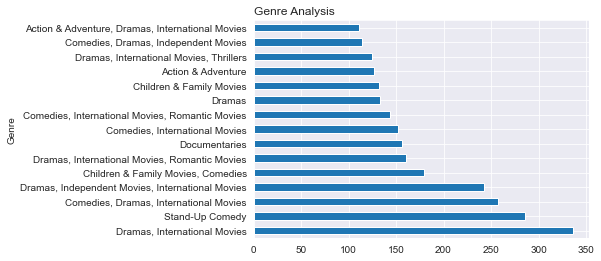

In [23]:
data.listed_in.value_counts().head(15).plot.barh()
plt.title('Genre Analysis', loc = 'left')
plt.ylabel('Genre');

### List of Cult Classic Movies

In [24]:
data[data.listed_in.str.contains('Cult Movies')]

,type,title,director,cast,country,date_added,release_year,rating,duration,listed_in,Year,Month
131,Movie,Blade Runner: The Final Cut,Ridley Scott,"Harrison Ford, Rutger Hauer, Sean Young, Edwar...",United States,2021-09-01,1982,R,117 min,"Action & Adventure, Classic Movies, Cult Movies",2021,9
144,Movie,House Party,Reginald Hudlin,"Christopher Reid, Christopher Martin, Robin Ha...",United States,2021-09-01,1990,R,104 min,"Comedies, Cult Movies",2021,9
145,Movie,House Party 2,"George Jackson, Doug McHenry","Christopher Reid, Christopher Martin, Martin L...",United States,2021-09-01,1991,R,94 min,"Comedies, Cult Movies, Music & Musicals",2021,9
155,Movie,Labyrinth,Jim Henson,"David Bowie, Jennifer Connelly, Frank Oz, Kevi...","United Kingdom, United States",2021-09-01,1986,PG,101 min,"Action & Adventure, Children & Family Movies, ...",2021,9
161,Movie,Mars Attacks!,Tim Burton,"Jack Nicholson, Glenn Close, Annette Bening, P...",United States,2021-09-01,1996,PG-13,106 min,"Comedies, Cult Movies, Sci-Fi & Fantasy",2021,9
...,...,...,...,...,...,...,...,...,...,...,...,...
8527,Movie,The Texas Chainsaw Massacre,Tobe Hooper,"Gunnar Hansen, Jim Siedow, Marilyn Burns, Edwi...",United States,2019-10-22,1974,R,83 min,"Cult Movies, Horror Movies, Independent Movies",2019,10
8598,Movie,"To Wong Foo, Thanks for Everything! Julie Newmar",Beeban Kidron,"Patrick Swayze, Wesley Snipes, John Leguizamo,...",United States,2019-08-01,1995,PG-13,108 min,"Comedies, Cult Movies, LGBTQ Movies",2019,8
8614,Movie,Trainspotting,Danny Boyle,"Ewan McGregor, Ewen Bremner, Jonny Lee Miller,...",United Kingdom,2019-10-01,1996,R,94 min,"Comedies, Cult Movies, Dramas",2019,10
8621,Movie,Tremors,Ron Underwood,"Kevin Bacon, Fred Ward, Finn Carter, Michael G...",United States,2020-01-01,1990,PG-13,96 min,"Comedies, Cult Movies, Horror Movies",2020,1


### Concentration of Movies and TV shows according to Year

In [25]:
px.bar(data, x = 'rating',y = 'Year', color = 'type',title= 'Concentration of Movies and TV shows according to Year')

### Independent Movies

In [26]:
data_independent_movies = data[data['listed_in'].str.contains('Independent Movies')]
data_independent_movies.Year.value_counts()

2019    197
2018    159
2020    147
2017    116
2021     82
2016     31
2015      7
2008      1
Name: Year, dtype: int64

In [27]:
data.groupby('listed_in').sum()

,release_year,Year,Month
listed_in,,,
Action & Adventure,255472,256493,844
"Action & Adventure, Anime Features, Children & Family Movies",8077,8081,17
"Action & Adventure, Anime Features, Classic Movies",1979,2018,5
"Action & Adventure, Anime Features, Horror Movies",2016,2021,4
"Action & Adventure, Anime Features, International Movies",66322,66636,254
...,...,...,...
"TV Comedies, TV Dramas",2016,2017,5
TV Dramas,2021,2021,5
"TV Horror, TV Mysteries, TV Thrillers",2015,2015,10


### TV Shows Analysis

2020    43
2019    29
2021    26
2017    22
2018    16
2016     7
2015     3
2013     1
Name: Year, dtype: int64


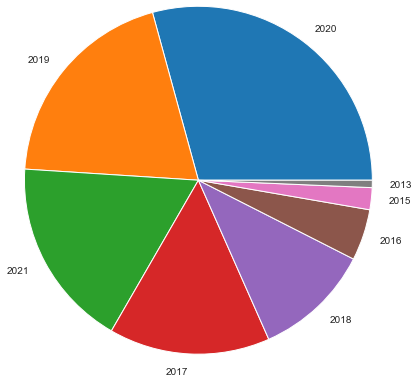

In [28]:
data_tv_shows = data[data.type == 'TV Show']
print(data_tv_shows['Year'].value_counts())
data_tv_shows['Year'].value_counts().plot.pie(radius = 2);

### Analysis of Old Movies that Netflix currently having

In [29]:
old_movies = data[data['type'] == 'Movie'].sort_values('release_year')
old_movies[['title','director','rating','duration','release_year','Year']].head(25)

,title,director,rating,duration,release_year,Year
8205,The Battle of Midway,John Ford,TV-14,18 min,1942,2017
8640,Tunisian Victory,"Frank Capra, John Huston, Hugh Stewart, Roy Bo...",TV-14,76 min,1944,2017
7219,Know Your Enemy - Japan,"Frank Capra, Joris Ivens",TV-14,63 min,1945,2017
7294,Let There Be Light,John Huston,TV-PG,58 min,1946,2017
8587,Thunderbolt,"William Wyler, John Sturges",TV-PG,42 min,1947,2017
1699,White Christmas,Michael Curtiz,TV-G,120 min,1954,2020
2375,The Blazing Sun,Youssef Chahine,TV-14,116 min,1954,2020
7954,Scandal in Sorrento,Dino Risi,TV-PG,93 min,1955,2020
8506,The Sign of Venus,Dino Risi,TV-14,97 min,1955,2020
7839,Rebel Without a Cause,Nicholas Ray,PG-13,111 min,1955,2019


In [30]:
data.dtypes

type                    object
title                   object
director                object
cast                    object
country                 object
date_added      datetime64[ns]
release_year             int64
rating                  object
duration                object
listed_in               object
Year                     int64
Month                    int64
dtype: object

### EDA Analysis with Dedicated Packages

In [31]:
dtale.show(data)

  0%|                                                                                         | 0/1295 [00:00<…

DataPrep Report
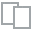
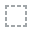
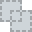
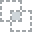
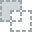
...
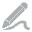
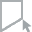
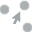
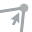
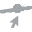

In [32]:
from dataprep.eda import create_report

report = create_report(data)
report